In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
df=pd.read_csv("temperature.csv")
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [3]:
df.shape

(7752, 25)

we have 7752 rows and 25 columns in this dataset.

In [4]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

We have object types and float types of values which are independent variable and the Next_Tmax,Next_Tmin is our target variable in this dataset.

In [5]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

we have 23 features and 2 target variables.

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [7]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

we can see lots of missing values in this dataset.

In [8]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [9]:
df["Next_Tmax"].unique()

array([29.1, 30.5, 31.1, 31.7, 31.2, 31.5, 30.9, 31.3, 32.6, 31.4, 30.8,
       33.1, 31.8, 30.6, 32. , 24.8, 27.3, 28.1, 27.9, 28.2, 28.9, 27.6,
       27.1, 27.5, 26.8, 28.7, 27.8, 29.2, 28.8, 30. , 30.1, 29.4, 31.6,
       30.2, 30.4, 32.5, 31. , 25.2, 28.4, 28.3, 27.4, 26.2, 28. , 26.7,
       28.6, 27.7, 28.5, 30.7, 29.6, 29.9, 29.3, 32.2, 33.6, 30.3, 32.3,
       29.8, 29.7, 29.5, 29. , 23.4, 26.4, 26.6, 26.1, 25.4, 27.2, 27. ,
       26.3, 25.5, 25.6, 25.9, 23. , 26.5, 26. , 25.7, 22.4, 25.8, 25.1,
       24.9, 24.3, 24.5, 25.3, 21.8, 24.7, 25. , 24.6, 23.6, 24.1, 23.2,
       23.7, 24.2, 23.8, 23.9, 31.9, 23.1, 33. , 32.7, 26.9, 32.1, 33.3,
       32.4, 33.4, 33.5, 34.8, 34. , 34.3, 34.5,  nan, 32.8, 33.7, 33.2,
       32.9, 34.1, 34.9, 35.3, 34.6, 35. , 33.9, 34.7, 36.6, 34.4, 35.8,
       35.2, 33.8, 35.6, 35.1, 34.2, 36. , 35.5, 35.4, 21.6, 23.5, 24.4,
       24. , 35.9, 36.1, 22.5, 22.8, 36.2, 21.1, 23.3, 22. , 22.7, 20.9,
       22.2, 22.1, 37. , 36.9, 22.9, 35.7, 37.1, 22

Next_Tmax ranges from 18.6 to 37.8 in this target column.

In [10]:
df["Next_Tmax"].value_counts()

29.3    113
33.0    106
31.3    104
29.6    101
31.2     98
       ... 
37.3      1
37.6      1
19.7      1
21.5      1
38.7      1
Name: Next_Tmax, Length: 183, dtype: int64

most values present in 29.3 column.

In [11]:
df["Next_Tmin"].unique()

array([21.2, 22.5, 23.9, 24.3, 24. , 23.4, 22.9, 21.6, 21. , 24.5, 22.2,
       22.8, 20.9, 21.1, 23. , 23.7, 23.2, 24.2, 18.7, 21.5, 21.8, 22.3,
       21.3, 20.7, 19.8, 20.8, 21.7, 22.1, 20.5, 21.9, 17.8, 20.1, 20.3,
       19.4, 19.1, 18.9, 20. , 19.7, 19.5, 20.6, 23.1, 23.3, 22.7, 22.6,
       22.4, 22. , 23.5, 23.8, 21.4, 19.3, 20.4, 19.9, 20.2, 24.1, 23.6,
       24.4, 24.8, 25.1, 24.6, 24.7, 25. , 24.9, 25.3, 26. , 26.1, 25.5,
       25.8, 25.4, 25.6, 25.7, 25.2, 25.9, 26.3, 26.2, 26.4, 26.5, 26.9,
        nan, 26.8, 26.6, 27. , 27.1, 26.7, 27.5, 27.2, 27.4, 27.7, 28.3,
       27.6, 28. , 27.3, 19.6, 19.2, 18.6, 18.5, 18.2, 18.4, 18.8, 17.9,
       17.5, 16.5, 18. , 19. , 16.7, 18.1, 18.3, 28.1, 28.4, 29.4, 29.1,
       28.5, 28.8, 29.8, 29.5, 28.6, 17.1, 16.8, 17.6, 17.4, 15.8, 16.9,
       17.7, 17.2, 15.5, 16.6, 16.4, 16.3, 17. , 14.7, 15.9, 16. , 17.3,
       15.4, 15.3, 13.8, 15.6, 15.1, 27.9, 28.7, 27.8, 28.2, 13.3, 14.1,
       15. , 11.3, 13.4, 15.7, 14.9, 16.2, 14.4, 16

Next_min ranges from 12.9 to 29.8 in this target column.

In [12]:
df["Next_Tmin"].value_counts()

23.5    159
23.4    157
24.0    156
23.2    150
23.8    149
       ... 
29.5      1
13.6      1
13.3      1
13.9      1
12.9      1
Name: Next_Tmin, Length: 157, dtype: int64

most values present in 159 column.

# EDA

univariate analysis

<AxesSubplot:xlabel='Next_Tmax', ylabel='count'>

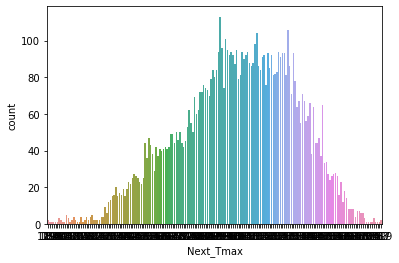

In [13]:
sns.countplot(df["Next_Tmax"])

In Next_Tmax countplot shows what value is  high in this column.

<AxesSubplot:xlabel='Next_Tmin', ylabel='count'>

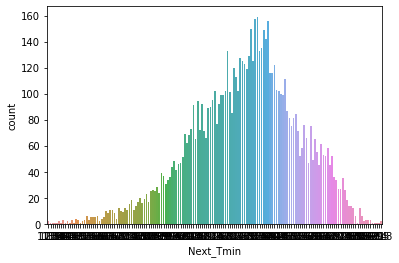

In [14]:
sns.countplot(df["Next_Tmin"])

In Next_Tmin countplot shows what value is high in this column.

<AxesSubplot:xlabel='station'>

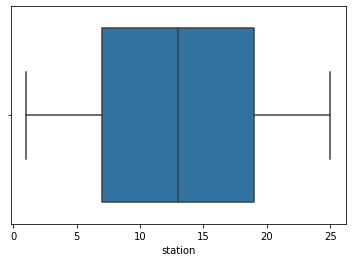

In [17]:
sns.boxplot(df["station"])

In this column has no outliers are present.

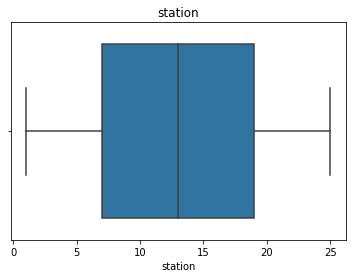

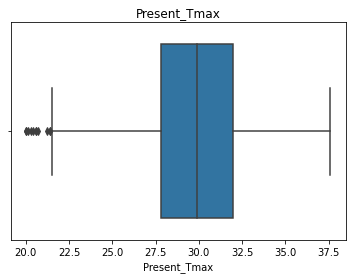

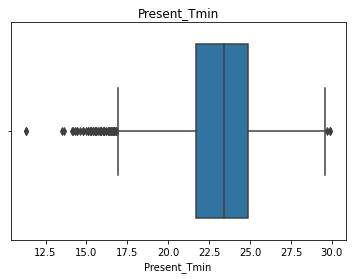

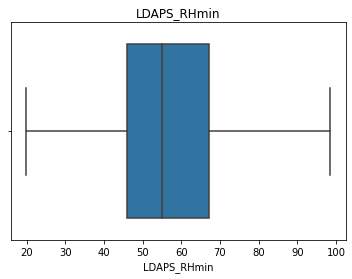

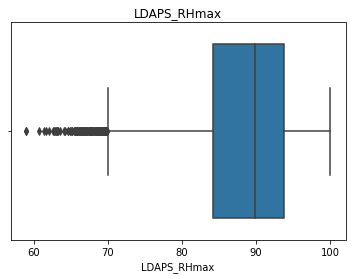

...

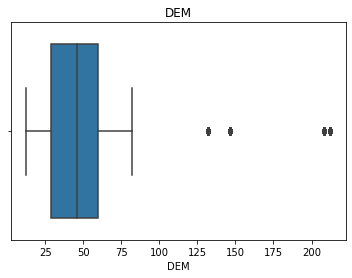

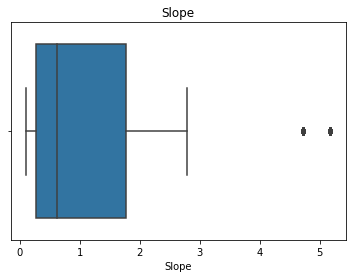

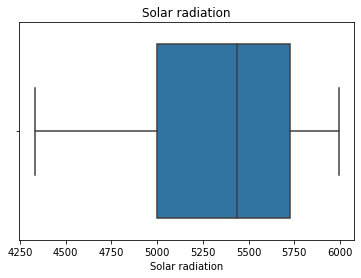

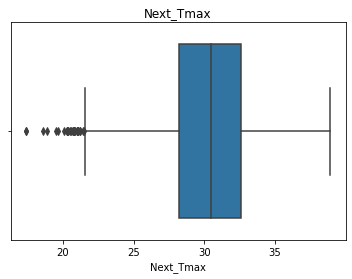

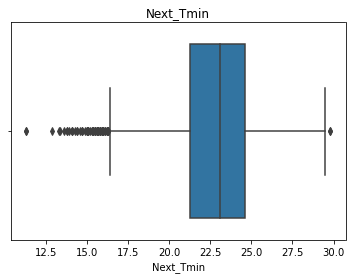

In [20]:
for col in ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin']:
    sns.boxplot(df[col].dropna(),orient='v')
    plt.title(col)
    plt.show()

In this dataset some columns has outliers are present and some columns has no outliers are present.

# Bivariate analysis

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


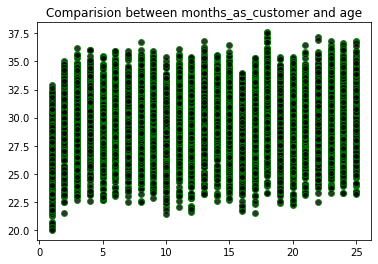

In [22]:
plt.scatter(df["station"],df["Present_Tmax"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between months_as_customer and age")
plt.show()

outliers are present in this plot.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


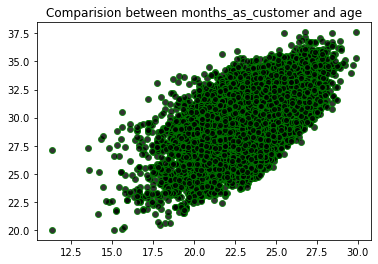

In [23]:
plt.scatter(df["Present_Tmin"],df["Present_Tmax"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between months_as_customer and age")
plt.show()

outliers are present in this plot.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


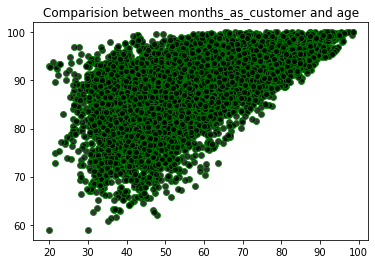

In [24]:
plt.scatter(df["LDAPS_RHmin"],df["LDAPS_RHmax"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between months_as_customer and age")
plt.show()

outliers are present in this plot.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


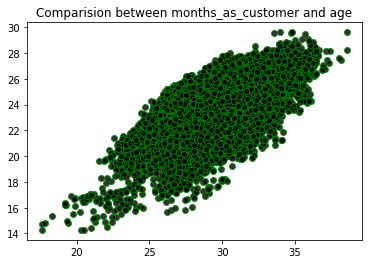

In [25]:
plt.scatter(df["LDAPS_Tmax_lapse"],df["LDAPS_Tmin_lapse"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between LDAPS_Tmax_lapse and LDAPS_Tmin_lapse")
plt.show()

outliers are present in this column.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


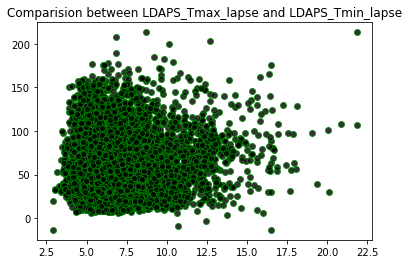

In [26]:
plt.scatter(df["LDAPS_WS"],df["LDAPS_LH"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between LDAPS_Tmax_lapse and LDAPS_Tmin_lapse")
plt.show()

outliers are present in this columns.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


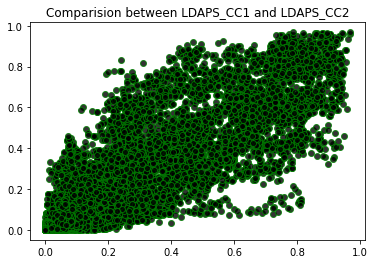

In [30]:
plt.scatter(df["LDAPS_CC1"],df["LDAPS_CC2"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between LDAPS_CC1 and LDAPS_CC2")
plt.show()

outliers are present in this column.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


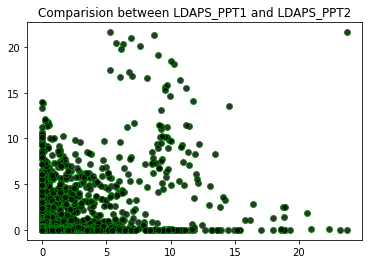

In [29]:
plt.scatter(df["LDAPS_PPT1"],df["LDAPS_PPT2"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between LDAPS_PPT1 and LDAPS_PPT2")
plt.show()

outliers are present in this plot.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


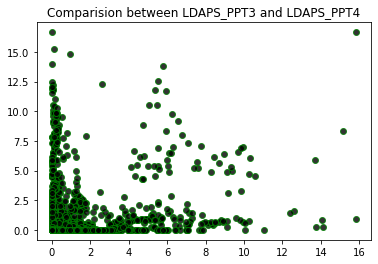

In [33]:
plt.scatter(df["LDAPS_PPT3"],df["LDAPS_PPT4"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between LDAPS_PPT3 and LDAPS_PPT4")
plt.show()

outliers are present.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


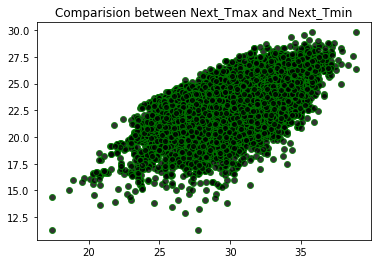

In [34]:
plt.scatter(df["Next_Tmax"],df["Next_Tmin"],alpha=0.8,c=(0,0,0),edgecolors='g')
plt.title("Comparision between Next_Tmax and Next_Tmin")
plt.show()

outliers are present in this plot.

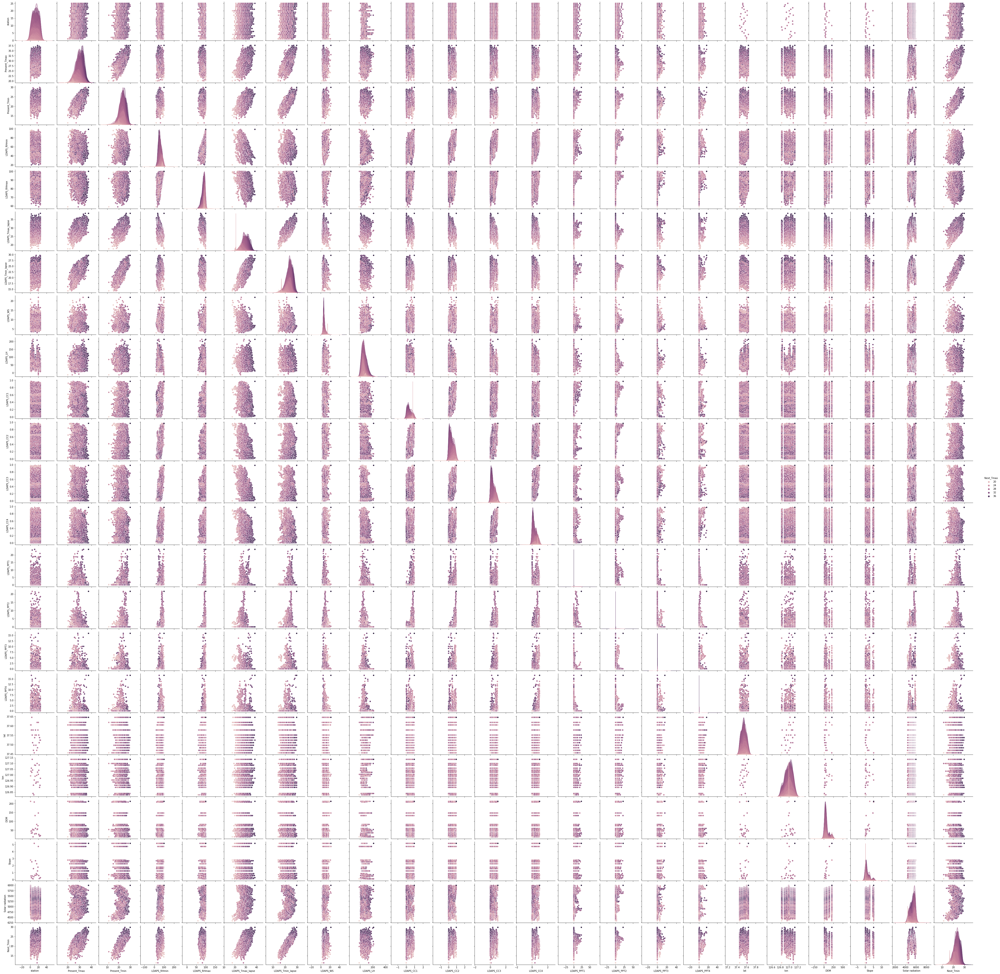

In [35]:
sns.pairplot(df,hue="Next_Tmax")

We can check the corelation between dependent and independent features using dataframe.corr() function. This plot pairwise relationships in a dataset.

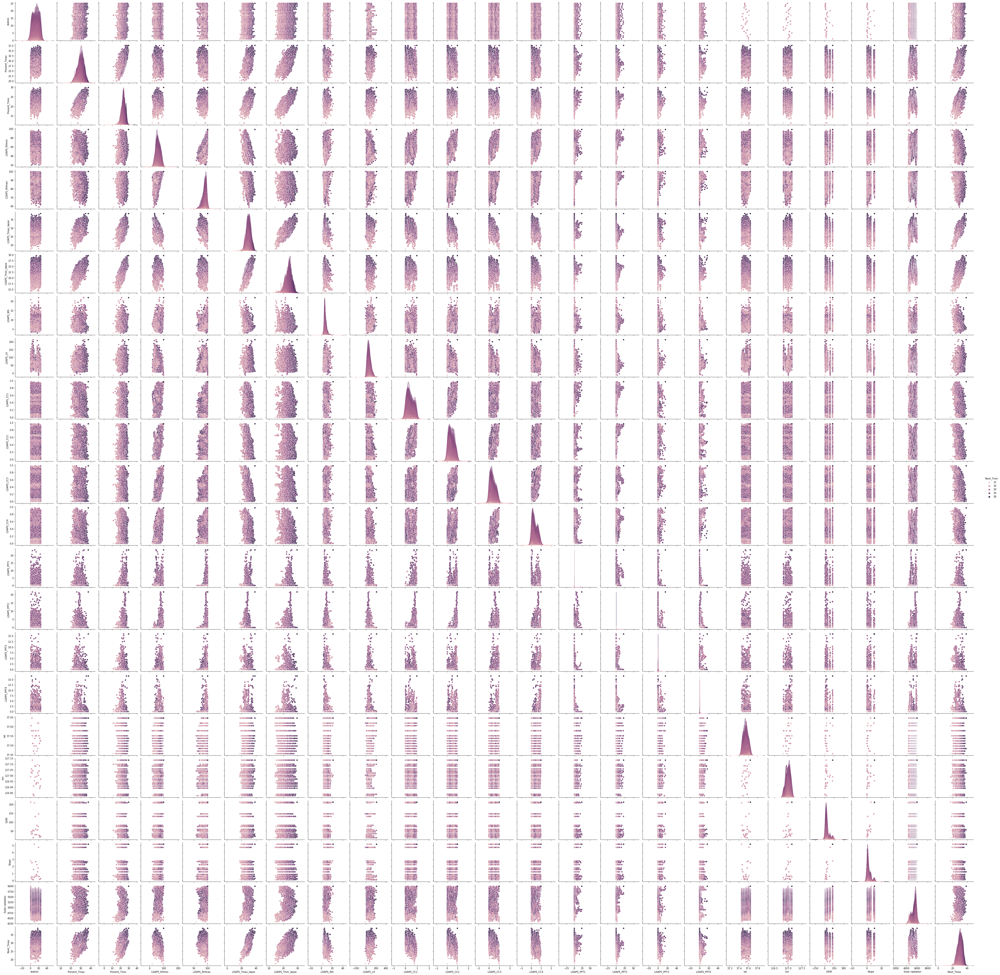

In [36]:
sns.pairplot(df,hue="Next_Tmin")

We can check the corelation between dependent and independent features using dataframe.corr() function. This plot pairwise relationships in a dataset.

# checking correlation

In [14]:
cor=df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.113211,0.132419,-0.067122,-0.168010,0.069561,0.105422,0.005320,-0.134226,0.006956,...,-0.008369,-0.012671,-0.010580,-0.237610,-0.118763,-0.255970,-0.090113,-0.019011,0.108306,0.128719
Present_Tmax,0.113211,1.000000,0.618760,-0.206782,-0.304209,0.575289,0.629247,-0.122876,0.136716,-0.314863,...,-0.100420,-0.121271,-0.101471,-0.052776,0.009075,-0.187855,-0.106097,-0.025557,0.613109,0.625252
Present_Tmin,0.132419,0.618760,1.000000,0.124921,-0.015334,0.470118,0.772921,-0.035111,-0.009368,0.085593,...,0.069095,-0.046645,-0.064394,-0.078715,-0.043725,-0.251257,-0.146736,0.053828,0.473868,0.799758
LDAPS_RHmin,-0.067122,-0.206782,0.124921,1.000000,0.579141,-0.564580,0.089476,0.294361,-0.070858,0.613818,...,0.390967,0.240642,0.168595,0.087523,-0.076608,0.102612,0.124346,0.244795,-0.442958,0.095830
LDAPS_RHmax,-0.168010,-0.304209,-0.015334,0.579141,1.000000,-0.373404,-0.114143,0.135333,0.238579,0.436652,...,0.229050,0.134607,0.117853,0.196751,0.025792,0.178031,0.220668,0.149699,-0.286478,-0.072490
LDAPS_Tmax_lapse,0.069561,0.575289,0.470118,-0.564580,-0.373404,1.000000,0.654021,-0.311996,0.048010,-0.438439,...,-0.242122,-0.188115,-0.160273,-0.042298,0.091107,-0.179766,-0.163123,0.048111,0.836144,0.591535
LDAPS_Tmin_lapse,0.105422,0.629247,0.772921,0.089476,-0.114143,0.654021,1.000000,-0.130035,-0.134761,0.010901,...,0.000870,-0.088575,-0.094655,-0.096726,-0.026831,-0.196407,-0.186753,0.160443,0.593195,0.886964
LDAPS_WS,0.005320,-0.122876,-0.035111,0.294361,0.135333,-0.311996,-0.130035,1.000000,0.006711,0.289445,...,0.191886,0.161684,0.144085,0.036836,-0.059756,0.191983,0.172464,0.122116,-0.346592,-0.097390
LDAPS_LH,-0.134226,0.136716,-0.009368,-0.070858,0.238579,0.048010,-0.134761,0.006711,1.000000,-0.147296,...,-0.077545,0.016102,0.019979,0.133870,0.025948,0.055402,0.087203,-0.047523,0.159324,-0.055895
LDAPS_CC1,0.006956,-0.314863,0.085593,0.613818,0.436652,-0.438439,0.010901,0.289445,-0.147296,1.000000,...,0.389453,0.168742,0.091722,-0.008170,-0.006876,-0.014159,-0.020853,0.218949,-0.457583,-0.011129


This column is checking correlation between different different columns.

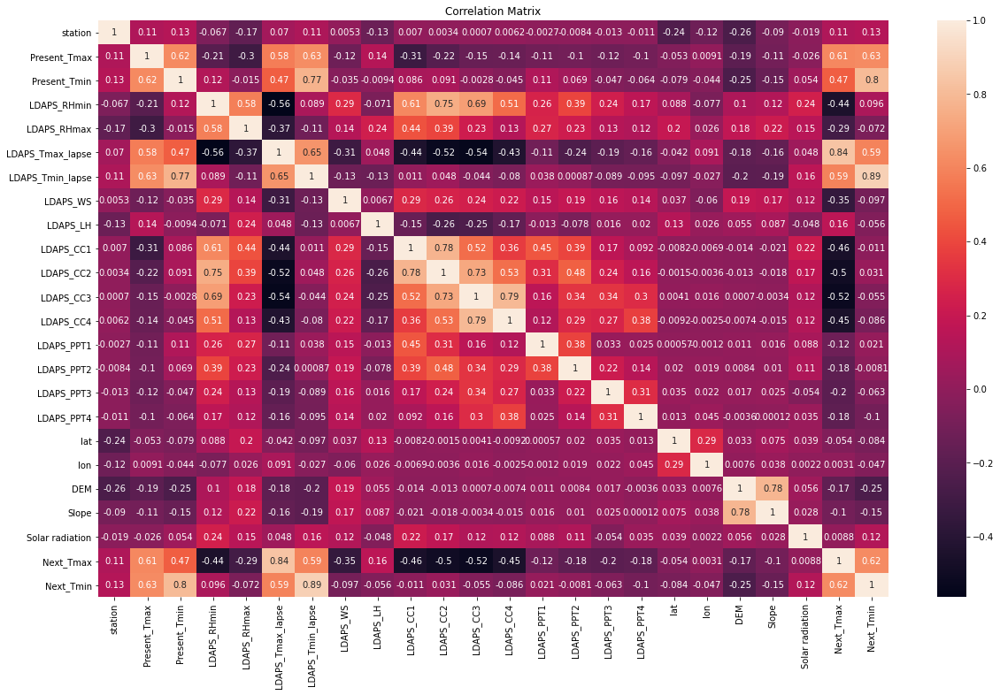

In [15]:
plt.figure(figsize=[20,12])
sns.heatmap(cor,annot=True)
plt.title("Correlation Matrix")
plt.show()

# correlation matrix

In [16]:
corr_matrix=df.corr()
corr_matrix["Next_Tmax"].sort_values(ascending=False)

Next_Tmax           1.000000
LDAPS_Tmax_lapse    0.836144
Next_Tmin           0.621427
Present_Tmax        0.613109
LDAPS_Tmin_lapse    0.593195
Present_Tmin        0.473868
LDAPS_LH            0.159324
station             0.108306
Solar radiation     0.008809
lon                 0.003060
lat                -0.053567
Slope              -0.102838
LDAPS_PPT1         -0.120079
DEM                -0.172674
LDAPS_PPT2         -0.180449
LDAPS_PPT4         -0.180669
LDAPS_PPT3         -0.196845
LDAPS_RHmax        -0.286478
LDAPS_WS           -0.346592
LDAPS_RHmin        -0.442958
LDAPS_CC4          -0.451324
LDAPS_CC1          -0.457583
LDAPS_CC2          -0.496251
LDAPS_CC3          -0.520706
Name: Next_Tmax, dtype: float64

I am finding the correlation value of each column. Their are identify the corrlation of independent variable with target variable "Next_Tmax".

In [17]:
corr_matrix=df.corr()
corr_matrix["Next_Tmin"].sort_values(ascending=False)

Next_Tmin           1.000000
LDAPS_Tmin_lapse    0.886964
Present_Tmin        0.799758
Present_Tmax        0.625252
Next_Tmax           0.621427
LDAPS_Tmax_lapse    0.591535
station             0.128719
Solar radiation     0.120400
LDAPS_RHmin         0.095830
LDAPS_CC2           0.031500
LDAPS_PPT1          0.021486
LDAPS_PPT2         -0.008131
LDAPS_CC1          -0.011129
lon                -0.046737
LDAPS_CC3          -0.055217
LDAPS_LH           -0.055895
LDAPS_PPT3         -0.063318
LDAPS_RHmax        -0.072490
lat                -0.083621
LDAPS_CC4          -0.085805
LDAPS_WS           -0.097390
LDAPS_PPT4         -0.104515
Slope              -0.147043
DEM                -0.247100
Name: Next_Tmin, dtype: float64

I am finding the correlation value of each column. Their are identify the corrlation of independent variable with target variable "Next_Tmin".

# Feature engneering

In [18]:
df["Day"]=pd.to_datetime(df["Date"]).dt.day

In [19]:
df["Month"]=pd.to_datetime(df["Date"]).dt.month

In [20]:
df["Year"]=pd.to_datetime(df["Date"]).dt.year

In [21]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,30.0,6.0,2013.0
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,30.0,6.0,2013.0
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,30.0,6.0,2013.0
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,30.0,6.0,2013.0
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,30.0,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,30.0,8.0,2017.0
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,30.0,8.0,2017.0
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,30.0,8.0,2017.0
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3,NaN,NaN,NaN


In [22]:
df.drop('Date',axis=1,inplace=True)

In [24]:
df.columns

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year'],
      dtype='object')

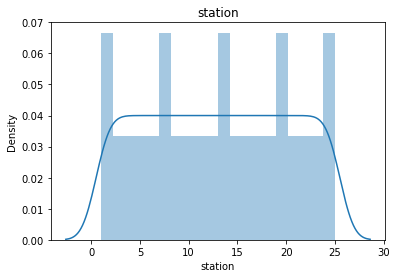

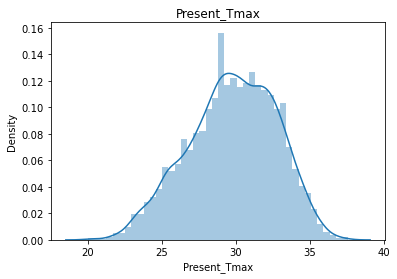

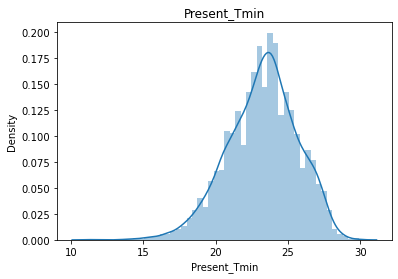

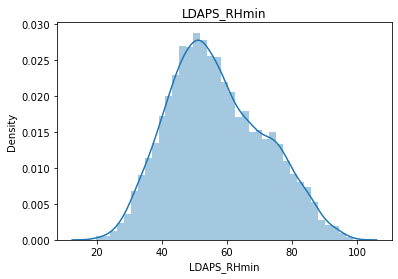

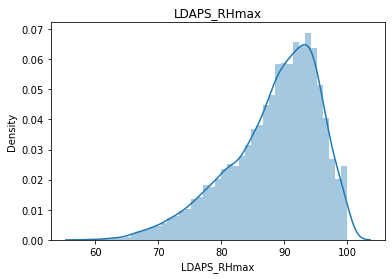

...

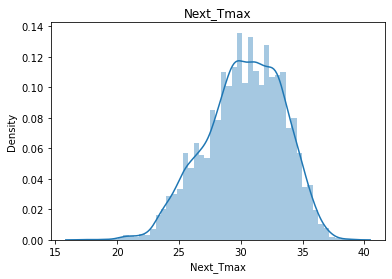

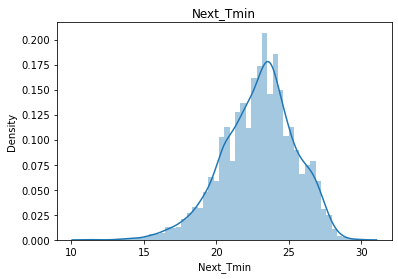

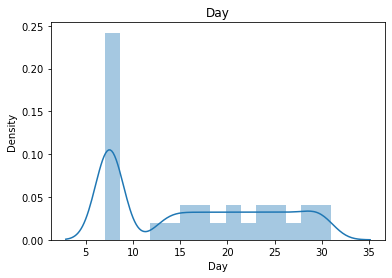

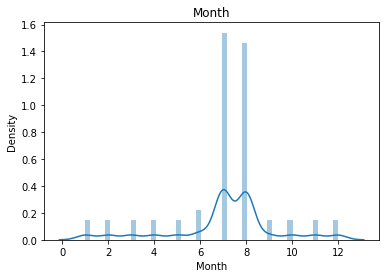

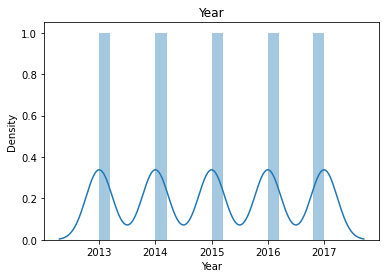

In [26]:
for col in ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'Month', 'Year']:
    sns.distplot(df[col].dropna())
    plt.title(col)
    plt.show()

In this dataset some columns has Data is normaly distributed.

# Handling missing values:

In [26]:
df["station"]=df["station"].fillna(df["station"].mean())

In [30]:
df["Present_Tmax"]=df["Present_Tmax"].fillna(df["Present_Tmax"].median())

In [32]:
df["Present_Tmin"]=df["Present_Tmin"].fillna(df["Present_Tmin"].mean())

In [34]:
df["LDAPS_RHmin"]=df["LDAPS_RHmin"].fillna(df["LDAPS_RHmin"].mean())

In [35]:
df["LDAPS_RHmax"]=df["LDAPS_RHmax"].fillna(df["LDAPS_RHmax"].median())

In [36]:
df["LDAPS_Tmax_lapse"]=df["LDAPS_Tmax_lapse"].fillna(df["LDAPS_Tmax_lapse"].mean())

In [37]:
df["LDAPS_Tmin_lapse"]=df["LDAPS_Tmin_lapse"].fillna(df["LDAPS_Tmin_lapse"].mean())

In [38]:
df["LDAPS_WS"]=df["LDAPS_WS"].fillna(df["LDAPS_WS"].median())

In [39]:
df["LDAPS_LH"]=df["LDAPS_LH"].fillna(df["LDAPS_LH"].median())

In [41]:
df["LDAPS_CC1"]=df["LDAPS_CC1"].fillna(df["LDAPS_CC1"].median())

In [42]:
df["LDAPS_CC2"]=df["LDAPS_CC2"].fillna(df["LDAPS_CC2"].median())

In [43]:
df["LDAPS_CC3"]=df["LDAPS_CC3"].fillna(df["LDAPS_CC3"].median())

In [44]:
df["LDAPS_CC4"]=df["LDAPS_CC4"].fillna(df["LDAPS_CC4"].median())

In [46]:
df["LDAPS_PPT1"]=df["LDAPS_PPT1"].fillna(df["LDAPS_PPT1"].mean())

In [47]:
df["LDAPS_PPT2"]=df["LDAPS_PPT2"].fillna(df["LDAPS_PPT2"].mean())

In [48]:
df["LDAPS_PPT3"]=df["LDAPS_PPT3"].fillna(df["LDAPS_PPT3"].mean())

In [52]:
df["Next_Tmax"]=df["Next_Tmax"].fillna(df["Next_Tmax"].mean())

In [53]:
df["Next_Tmin"]=df["Next_Tmin"].fillna(df["Next_Tmin"].mean())

In [55]:
df["Day"]=df["Day"].fillna(df["Day"].median())

In [56]:
df["Month"]=df["Month"].fillna(df["Month"].median())

In [57]:
df["Year"]=df["Year"].fillna(df["Year"].median())

In [58]:
df.isnull().sum()

station             0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
Day                 0
Month               0
Year                0
dtype: int64

There is no missing values in this dataset.

# outlier removal

In [66]:
from scipy.stats import zscore
z=np.abs(zscore(df))

new_df=df[(z<5).all(axis=1)]

In [67]:
new_df

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Day,Month,Year
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2,30.0,6.0,2013.0
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5,30.0,6.0,2013.0
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9,30.0,6.0,2013.0
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3,30.0,6.0,2013.0
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5,30.0,6.0,2013.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7746,22.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,...,37.5102,127.086,21.9668,0.133200,4441.803711,28.0,17.1,30.0,8.0,2017.0
7747,23.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,...,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1,30.0,8.0,2017.0
7748,24.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,...,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8,30.0,8.0,2017.0
7749,25.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,0.048954,...,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4,30.0,8.0,2017.0


In [68]:
new_df.shape

(7529, 27)

In [69]:
df.shape

(7752, 27)

In [70]:
(223/7752)*100

2.8766769865841075

outliers are removed in df.

# skewness

In [71]:
x=df.drop("Next_Tmax",axis=1)
y=df["Next_Tmax"]

In [73]:
x.skew()

station             0.000000
Present_Tmax       -0.265337
Present_Tmin       -0.367538
LDAPS_RHmin         0.300220
LDAPS_RHmax        -0.860210
LDAPS_Tmax_lapse   -0.227880
LDAPS_Tmin_lapse   -0.581763
LDAPS_WS            1.584975
LDAPS_LH            0.678315
LDAPS_CC1           0.465003
LDAPS_CC2           0.477041
LDAPS_CC3           0.646670
LDAPS_CC4           0.673700
LDAPS_PPT1          5.393821
LDAPS_PPT2          5.775355
LDAPS_PPT3          6.457129
LDAPS_PPT4          5.393821
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.340200
Day                 0.245548
Month              -0.705303
Year                0.000000
dtype: float64

In [74]:
from sklearn.preprocessing import power_transform
new_df=power_transform(x)

new_df=pd.DataFrame(new_df,columns=x.columns)

In [78]:
new_df.skew()

station            -0.204565
Present_Tmax       -0.035123
Present_Tmin       -0.012048
LDAPS_RHmin        -0.017469
LDAPS_RHmax        -0.116481
LDAPS_Tmax_lapse   -0.009351
LDAPS_Tmin_lapse   -0.017827
LDAPS_WS            0.002449
LDAPS_LH            0.058865
LDAPS_CC1           0.048127
LDAPS_CC2           0.046422
LDAPS_CC3           0.089672
LDAPS_CC4           0.129826
LDAPS_PPT1          1.404189
LDAPS_PPT2          1.577808
LDAPS_PPT3          1.747820
LDAPS_PPT4          1.404189
lat                 0.000000
lon                -0.198429
DEM                 0.039456
Slope               0.233968
Solar radiation    -0.176636
Next_Tmax          -0.038540
Day                -0.041864
Month               0.043843
Year               -0.000215
dtype: float64

skewness has been removed.

# standard scaler

In [79]:
from sklearn.preprocessing import StandardScaler

scaling=StandardScaler()
scaledX=scaling.fit_transform(df)

In [80]:
scaledX

array([[-1.6643153 , -0.36172509, -0.75952931, ...,  1.65407295,
        -0.48286762, -1.41439603],
       [-1.52562236,  0.72067506, -0.6762959 , ...,  1.65407295,
        -0.48286762, -1.41439603],
       [-1.38692941,  0.61920005,  0.03118815, ...,  1.65407295,
        -0.48286762, -1.41439603],
       ...,
       [ 1.6643153 , -2.22210036, -2.42419767, ...,  1.65407295,
         0.41081503,  1.41439603],
       [ 0.        , -3.30450051, -4.9628169 , ..., -0.04501017,
        -0.03602629,  0.        ],
       [ 0.        ,  2.64870034,  2.77789093, ..., -0.04501017,
        -0.03602629,  0.        ]])

# Building Machine Learning Models

In [106]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from math import sqrt
from sklearn import metrics
from sklearn.metrics import mean_squared_error,mean_absolute_error

In [82]:
# training testing and splitting the dataset
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.3, random_state = 42)

In [94]:
print("The size of training input is", x_train.shape)
print("The size of training output is", y_train.shape)
print(50 *'*')
print("The size of testing input is", x_test.shape)
print("The size of testing output is", y_test.shape)

The size of training input is (5426, 26)
The size of training output is (5426,)
**************************************************
The size of testing input is (2326, 26)
The size of testing output is (2326,)


# LinearRegression

In [107]:
lr = LinearRegression()
lr.fit(x_train,y_train)
y_train_pred = lr.predict(x_train)
y_test_pred = lr.predict(x_test)

In [114]:
print("The Results for LinearRegression Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train.values, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train.values, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train.values, y_train_pred)))

The Results for LinearRegression Model:
--------------------------------------------------
Mean_absolute_error 0.7670804538293268
Mean_squared_error 0.9450476112197618
R-squared: 0.9721355930217563


# RandomForestRegressor

In [115]:
rdr = RandomForestRegressor()
rdr.fit(x_train,y_train)
y_train_pred = rdr.predict(x_train)
y_test_pred = rdr.predict(x_test)

In [116]:
print("The Results for Random Forest Regressor Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))

The Results for Random Forest Regressor Model:
--------------------------------------------------
Mean_absolute_error 0.2101264344633356
Mean_squared_error 0.07854704004696006
R-squared: 0.28026244851381726


# Ridge

In [117]:
rd = Ridge()
rd.fit(x_train,y_train)
y_train_pred = rd.predict(x_train)
y_test_pred = rd.predict(x_test)

In [118]:
print("The Results for Ridge Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))

The Results for Ridge Model:
--------------------------------------------------
Mean_absolute_error 0.7670475496994559
Mean_squared_error 0.9450536266180147
R-squared: 0.9721386869259009


# Lasso

In [119]:
lss = Lasso()
lss.fit(x_train,y_train)
y_train_pred = lss.predict(x_train)
y_test_pred = lss.predict(x_test)

In [120]:
print("The Results for Lasso Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))

The Results for Lasso Model:
--------------------------------------------------
Mean_absolute_error 0.8799626959200997
Mean_squared_error 1.2388876014669188
R-squared: 1.1130532788087544


# Decision Tree Regressor

In [121]:
dtc = DecisionTreeRegressor()
dtc.fit(x_train,y_train)
y_train_pred = dtc.predict(x_train)
y_test_pred = dtc.predict(x_test)

In [122]:
print("The Results for Decision Tree Regressor Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train, y_train_pred)))

The Results for Decision Tree Regressor Model:
--------------------------------------------------
Mean_absolute_error 3.142835543354664e-17
Mean_squared_error 1.116559482509652e-31
R-squared: 3.3414958963159776e-16


# K Neighbors Regressor

In [123]:
knn = KNeighborsRegressor()
knn.fit(x_train,y_train)
y_train_pred = knn.predict(x_train)
y_test_pred = knn.predict(x_test)

In [124]:
print("The Results for K Neighbors Regressor Model:")
print(50 * '-')
print('Mean_absolute_error', metrics.mean_absolute_error(y_train.values, y_train_pred))
print('Mean_squared_error', metrics.mean_squared_error(y_train.values, y_train_pred))
print('R-squared:', np.sqrt(metrics.mean_squared_error(y_train.values, y_train_pred)))

The Results for K Neighbors Regressor Model:
--------------------------------------------------
Mean_absolute_error 1.0606583958096996
Mean_squared_error 1.9147962928359366
R-squared: 1.3837616459621709


# cross validation of the model

In [125]:
from sklearn.model_selection import cross_val_score

In [126]:
print(cross_val_score(dtc,x,y,cv=5).mean())

0.5789853263835961


In [127]:
print(cross_val_score(knn,x,y,cv=5).mean())

0.06278515461483121


In [128]:
print(cross_val_score(rdr,x,y,cv=5).mean())

0.7857145523766762


In [129]:
print(cross_val_score(rd,x,y,cv=5).mean())

0.7879927168114615


In [130]:
print(cross_val_score(lss,x,y,cv=5).mean())

0.7462808906628583


In [131]:
print(cross_val_score(lr,x,y,cv=5).mean())

0.7878915156419856


# Hyper parameter tuning

In [132]:
from sklearn.model_selection import GridSearchCV
params ={'alpha' :[0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
ridge_regressor =GridSearchCV(Ridge(), params ,cv =5,scoring = 'neg_mean_absolute_error', n_jobs =-1)
ridge_regressor.fit(x_train ,y_train)

GridSearchCV(cv=5, estimator=Ridge(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [133]:
ridge_regressor.best_score_

-0.7701644917303149

In [134]:
params ={'alpha' :[0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000, 10000, 100000]}
lasso_regressor =GridSearchCV(Lasso(), params ,cv =15,scoring = 'neg_mean_absolute_error', n_jobs =-1)
lasso_regressor.fit(x_train ,y_train)

GridSearchCV(cv=15, estimator=Lasso(), n_jobs=-1,
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000,
                                   10000, 100000]},
             scoring='neg_mean_absolute_error')

In [135]:
lasso_regressor.best_score_

-0.7699641405254333

In [136]:
k_range = list(range(1, 30))
params = dict(n_neighbors = k_range)
knn_regressor = GridSearchCV(KNeighborsRegressor(), params, cv =10, scoring = 'neg_mean_squared_error')
knn_regressor.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsRegressor(),
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14, 15, 16, 17, 18, 19, 20, 21, 22,
                                         23, 24, 25, 26, 27, 28, 29]},
             scoring='neg_mean_squared_error')

In [137]:
knn_regressor.best_score_

-2.929904449726542

In [138]:
depth  =list(range(3,30))
param_grid =dict(max_depth =depth)
tree =GridSearchCV(DecisionTreeRegressor(),param_grid,cv =10)
tree.fit(x_train,y_train)

GridSearchCV(cv=10, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14,
                                       15, 16, 17, 18, 19, 20, 21, 22, 23, 24,
                                       25, 26, 27, 28, 29]})

In [139]:
tree.best_score_

0.8238291307111625

In [140]:
from sklearn.model_selection import RandomizedSearchCV

tuned_params = {'n_estimators': [100, 200, 300, 400, 500], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4]}
random_regressor = RandomizedSearchCV(RandomForestRegressor(), tuned_params, n_iter = 20, scoring = 'neg_mean_absolute_error', cv = 5, n_jobs = -1)
random_regressor.fit(x_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=20,
                   n_jobs=-1,
                   param_distributions={'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 300, 400,
                                                         500]},
                   scoring='neg_mean_absolute_error')

In [141]:
random_regressor.best_score_

-0.57981709661973

Decision Tree  Regressor is giving Maximum Accuracy as compare to other Regressor algorithm.Hence Decision Tree Regressor is the best model of this dataset.

# saving the model

In [143]:
import pickle
filename='Temperature forest.pkl'
pickle.dump(rdr,open(filename,'wb'))

# conclusion

In [144]:
loaded_model=pickle.load(open('Temperature forest.pkl','rb'))
result=loaded_model.score(x_test,y_test)
print(result)

0.9058354692602003


In [145]:
conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],y_test_pred[:]],index=["predicted","original"])

In [146]:
conclusion

,0,1,2,3,4,5,6,7,8,9,...,2316,2317,2318,2319,2320,2321,2322,2323,2324,2325
predicted,20.143,27.585,21.304322,25.626,26.263,19.20,24.846967,22.17,26.299,22.983322,...,22.27,24.538,23.857,23.943,25.806,22.384,23.066,25.405,22.23,22.578322
original,21.940,26.760,22.020000,23.180,25.040,20.88,24.760000,22.28,25.100,23.420000,...,23.18,25.800,22.800,25.760,25.280,22.500,21.420,24.540,22.50,25.560000
